<a href="https://colab.research.google.com/github/nitingarg2015/EVA8/blob/master/Assignment%2012/Object%20detection%20using%20YoloV5/PPE_using_Yolov7.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Clone git repository: https://github.com/ultralytics/yolov5

In [2]:
!git clone https://github.com/ultralytics/yolov5  # clone

Cloning into 'yolov5'...
remote: Enumerating objects: 15352, done.
remote: Counting objects: 100% (17/17), done.
remote: Compressing objects: 100% (17/17), done.
remote: Total 15352 (delta 5), reused 4 (delta 0), pack-reused 15335
Receiving objects: 100% (15352/15352), 14.22 MiB | 19.63 MiB/s, done.
Resolving deltas: 100% (10525/10525), done.


# Mount Google Drive

In [3]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


## Copy custom dataset
Create folder "datasets" in the root directory. Unzip custom dataset into this directory

In [4]:
#copy custom data folder to data folder

zippath = "/content/gdrive/MyDrive/ColabNotebooks/Samplecodes/yolov4piford/data/cusdata.zip"

from zipfile import ZipFile

with ZipFile(zippath, 'r') as zip:
  zip.extractall("/content/datasets")
  print('Done')

Done


## Install Requirements

Change directory to yolov5 and install requirements

In [5]:
%cd yolov5
!pip install -r requirements.txt  # install

/content/yolov5
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 KB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 KB 7.3 MB/s eta 0:00:00


In [5]:
!pwd

/content/yolov5


## Custom train using yolov5m.pt weights

Make following changes in data/coco128.yaml
1. path: ../datasets/cusdata
2. train: images
3. val: images

classes: person, vest, red, blue, white, yellow (remove all other classes)

In [7]:
#!python train.py --img 640 --epochs 50 --data coco128.yaml --weights yolov5m.pt

train: weights=yolov5m.pt, cfg=, data=coco128.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-131-g0c8de3f Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4,

##Copy trained best.pt to required folder
This was generated as part of above training run

In [6]:
#copy best weights file to runs/train/exp2/weights/
!cp /content/gdrive/MyDrive/ColabNotebooks/Samplecodes/YoloV3/best.pt /content/yolov5/runs/train/exp/weights

## Extract frames from Youtube Video

In [ ]:
import cv2

# Set the path of the video file
video_path = "/content/smallclip.mp4"

# Set the number of frames to skip (every Nth frame)
skip_frames = 1

# Open the video file
cap = cv2.VideoCapture(video_path)

# Initialize a frame counter
frame_count = 10000

# Loop through the video frames
while cap.isOpened():
    # Read the current frame
    ret, frame = cap.read()

    # Check if the frame was read successfully
    if ret:
        # Increment the frame counter
        frame_count += 1

        # If the current frame is a multiple of N, save it as an image
        if frame_count % skip_frames == 0:
            # Set the file name for the saved image
            img_path = f"/content/clip/frame_{frame_count}.jpg"

            # Save the current frame as an image
            cv2.imwrite(img_path, frame)

    # If the frame was not read successfully, exit the loop
    else:
        break

# Release the video capture object and close all windows
cap.release()
cv2.destroyAllWindows()


## Make Predictions

In [7]:
!python detect.py --weights runs/train/exp/weights/best.pt --source /content/clip

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/clip, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-131-g0c8de3f Python-3.9.16 torch-1.13.1+cu116 CPU

Fusing layers... 
Model summary: 212 layers, 20873139 parameters, 0 gradients, 47.9 GFLOPs
image 1/262 /content/clip/frame_10001.jpg: 384x640 1 person, 1 vest, 2 yellows, 579.0ms
image 2/262 /content/clip/frame_10002.jpg: 384x640 1 person, 1 vest, 1 yellow, 593.3ms
image 3/262 /content/clip/frame_10003.jpg: 384x640 1 person, 1 vest, 1 yellow, 543.9ms
image 4/262 /content/clip/frame_10004.jpg: 384x640 1 person, 1 vest, 1 yellow, 535.1ms
image 5/262 /content/clip/

## Show results for 16 images

<ipython-input-21-7e81c669d672>:30: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  img_array = np.array(img_list)
<ipython-input-21-7e81c669d672>:30: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  img_array = np.array(img_list)


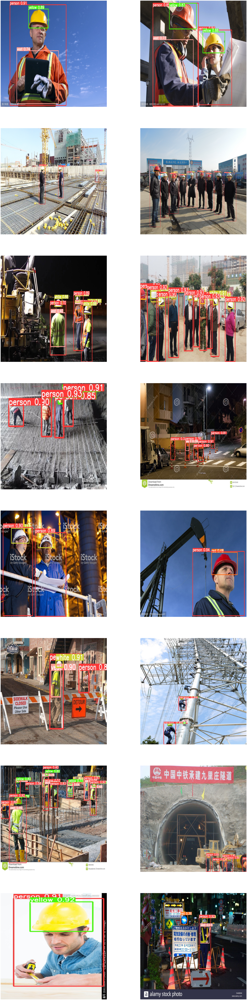

In [21]:
folder_path = "/content/yolov5/runs/detect/exp3"

import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

# Set the directory of the images
img_dir = "/content/yolov5/runs/detect/exp3"

# Set the size of the images
new_size = (400, 400)

# Create a list to store the resized images
img_list = []

# Loop through all the files in the directory
for file_name in os.listdir(img_dir):
    # Open the image
    img_path = os.path.join(img_dir, file_name)
    img = Image.open(img_path)

    # Resize the image
    img_resized = img.resize(new_size)

    # Add the resized image to the list
    img_list.append(img_resized)

# Convert the list to a NumPy array
img_array = np.array(img_list)

# Get the number of rows and columns for the grid
n_rows, n_cols = 8, 2

# Create a figure and axes for the grid
fig, axs = plt.subplots(n_rows, n_cols, figsize=(50, 200))

# Loop through the rows and columns of the grid
for i in range(n_rows):
    for j in range(n_cols):
        # Get the index of the image in the flattened array
        idx = i * n_cols + j

        # Display the image in the current grid cell
        if idx < len(img_array):
            axs[i, j].imshow(img_array[idx])
            axs[i, j].axis('off')
        else:
            axs[i, j].axis('off')

# Show the grid
plt.show()



## Convert predictions of video frames to a video

In [8]:
import os
import cv2

# Set the directory of the input images
img_dir = "/content/yolov5/runs/detect/exp"

# Set the path of the output video file
video_path = "/content/video.avi"

# Set the frame rate of the output video (frames per second)
fps = 15

# Set the size of the output video
frame_size = (640, 480)

# Get the file names of the input images
img_files = [os.path.join(img_dir, f) for f in os.listdir(img_dir) if f.endswith(".jpg")]

# Sort the input images by file name
img_files.sort()

# Initialize a video writer object
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter(video_path, fourcc, fps, frame_size)

# Loop through the input images
for img_file in img_files:
    # Read the current image
    img = cv2.imread(img_file)

    # Resize the image to the size of the output video
    img_resized = cv2.resize(img, frame_size)

    # Write the resized image to the video file
    out.write(img_resized)

# Release the video writer object and close all windows
out.release()
cv2.destroyAllWindows()
